In [162]:
from HeaderP import *

In [163]:
import astropy.units as u
from astropy.coordinates import SkyCoord
from astroquery.gaia import Gaia
from matplotlib.patches import Rectangle
from matplotlib.collections import PatchCollection


In [164]:
# from So
colnames = ['oid','expid','hjd','mjd','mag','magerr','catflags','filtercode',
                     'ra','dec','chi','sharp','filefracday','field','ccdid','qid','limitmag','magzp',
                     'magzprms','clrcoeff','clrcounc','exptime','airmass','programid']
import requests
def download_ztf_archive_lightcurves(ra, dec, objids=[], sr=0.001):
    ra = str(ra)
    dec = str(dec)
    url1 = "https://irsa.ipac.caltech.edu/cgi-bin/ZTF/nph_light_curves?POS=CIRCLE "
    url2 = f"{ra} {dec} {sr}&BANDNAME=r&NOBS_MIN=30&BAD_CATFLAGS_MASK=32768&FORMAT=ipac_table"
    url = url1 + url2
    r = requests.get(url)
    f = open(f"./lc/ra_{ra}_dec_{dec}", "wb")
    f.write(r.content)  # save to file
 
    mainlc = pd.read_table(f"./lc/ra_{ra}_dec_{dec}",
                          delim_whitespace=True, skiprows=54, names=colnames)
    if len(mainlc)==0:
        os.remove(f"./lc/ra_{ra}_dec_{dec}")
        return objids
    else:
        ojid_sing = mainlc['oid'].values[0]
        
    if ojid_sing in objids:
        os.remove(f"./lc/ra_{ra}_dec_{dec}")
    else:
        objids.append(ojid_sing)
    return objids
    

In [165]:
data = pd.read_pickle('gaia_obsnumb_absg7.pkl')
gaiadata = pd.read_pickle('gaia_color_greater1.pkl')

In [166]:
data.columns

Index(['source_id', 'ra', 'dec', 'parallax', 'parallax_error', 'gmag', 'bp_rp',
       'pmra', 'pmdec', 'dr2_radial_velocity', 'dr2_radial_velocity_error',
       'ruwe', 'abs_G', 'ZTFobsNumb', 'ZTF_g_lc_Numb', 'ZTF_r_lc_Numb',
       'ZTF_i_lc_Numb'],
      dtype='object')

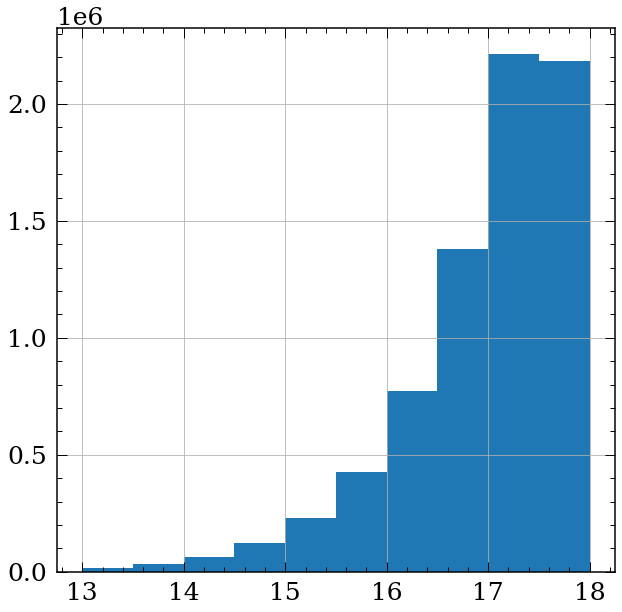

In [169]:
data['gmag'].hist()
data = data.loc[data['gmag']<16].reset_index(drop=True)


In [170]:
np.shape(data)

(891401, 17)

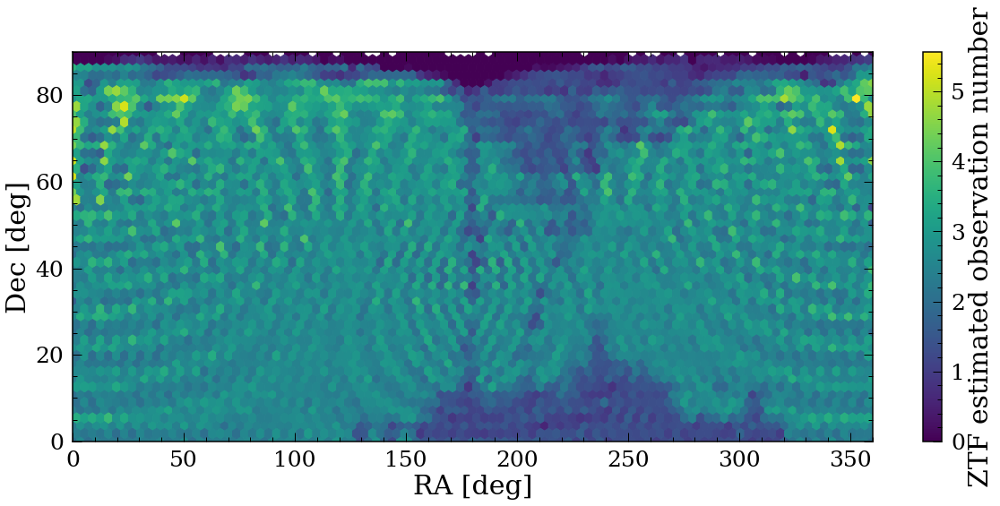

In [171]:
fig, ax = plt.subplots(figsize=(20,8))
plt.hexbin(data['ra'], data['dec'], C = data['ZTF_r_lc_Numb'], extent = (0,360,0,90), gridsize=(100, 25))
plt.xlim([0, 360])
plt.ylim([0, 90])
plt.xlabel('RA [deg]')
plt.ylabel('Dec [deg]')
cb = plt.colorbar()
cb.set_label('ZTF estimated observation number')

43


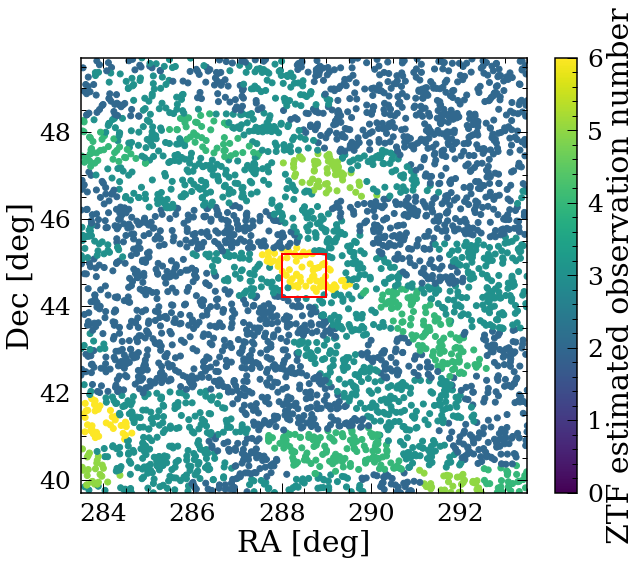

In [172]:
# check a small patch
xcenter, ycenter = 288.5, 44.7
boxsize = 1


fig, ax = plt.subplots(figsize=(10,8))
m_plt =(abs(data['ra']-xcenter)<5*boxsize)&(abs(data['dec']-ycenter)<5*boxsize).values
data_plt = data.loc[m_plt].reset_index(drop=True)
plt.scatter(data_plt['ra'], data_plt['dec'], c = data_plt['ZTF_r_lc_Numb'], vmin = 0, vmax=6)
plt.xlabel('RA [deg]')
plt.ylabel('Dec [deg]')
plt.xlim([xcenter-5*boxsize,xcenter+5*boxsize])
plt.ylim([ycenter-5*boxsize,ycenter+5*boxsize])
cb = plt.colorbar()
cb.set_label('ZTF estimated observation number')
selbox = Rectangle((xcenter - boxsize/2, ycenter - boxsize/2), boxsize, boxsize, edgecolor = 'r',
                  fill=None, linewidth=2)
ax.add_patch(selbox)

m =(abs(data['ra']-xcenter)<boxsize/2)&(abs(data['dec']-ycenter)<boxsize/2).values
data_subset = data.loc[m].reset_index(drop=True)
"""
plt.scatter(data_subset['ra'], data_subset['dec'], c = data_subset['ZTF_r_lc_Numb'], edgecolor='r',
           vmin = 0, vmax=6)
"""
print(len(data_subset))

In [176]:
ras = data_subset['ra'].values
decs = data_subset['dec'].values
print(np.shape(ras))

(43,)


In [196]:
import io
import os
from astropy.timeseries import LombScargle
import warnings
warnings.filterwarnings('ignore')

def processlc(maincord, gaiaras, gaiadecs, searchradius=5*60, pltorg=False):
    # search radius is arcmin
    colnames = ['oid','expid','hjd','mjd','mag','magerr','catflags','filtercode',
                     'ra','dec','chi','sharp','filefracday','field','ccdid','qid','limitmag','magzp',
                     'magzprms','clrcoeff','clrcounc','exptime','airmass','programid']
    
    if os.path.exists('./lc/ra_'+str(maincord[0])+'_dec_'+str(maincord[1])):
        mainlc = pd.read_table('./lc/ra_'+str(maincord[0])+'_dec_'+str(maincord[1]),
                               delim_whitespace=True, skiprows=54, names=colnames)
    else:
        return 0,0,0,0
    mainlc = mainlc.sort_values(by='mjd').reset_index(drop=True)
    normtime = min(mainlc['mjd'])
    mainlc['mjd'] = mainlc['mjd']-normtime
    mainlc['mag'] = mainlc['mag']-np.median(mainlc['mag'])
    
    dist = (np.sqrt((gaiaras-maincord[0])**2+(gaiadecs-maincord[1])**2)<searchradius/60/60)
    nbs_ra, nbs_dec = gaiaras[dist], gaiadecs[dist]
    
    times = np.zeros(0)
    mags = np.zeros(0)
    print('getting nearby %d lcs...'%(len(nbs_ra)))
    count_nl = 0
    for i in trange(len(nbs_ra)):
        if os.path.exists('./lc/ra_'+str(nbs_ra[i])+'_dec_'+str(nbs_dec[i])):
            lc = pd.read_table('./lc/ra_'+str(nbs_ra[i])+'_dec_'+str(nbs_dec[i]),
                               delim_whitespace=True, skiprows=54, names=colnames)
            count_nl=count_nl+1
        else:
            download_ztf_archive_lightcurves(nbs_ra[i], nbs_dec[i], objids, sr=0.0003)
            try:
                lc = pd.read_table('./lc/ra_'+str(nbs_ra[i])+'_dec_'+str(nbs_dec[i]),
                               delim_whitespace=True, skiprows=54, names=colnames)
                count_nl=count_nl+1
            except:
                print('no lcs!')
                continue
            
        lc = lc.sort_values(by='mjd').reset_index(drop=True)
        if len(lc)==0:
            continue
        lc['mjd'] = lc['mjd']-normtime
        lc['mag'] = lc['mag']-np.median(lc['mag'].dropna())
        
        #t, mag = fitpoly((lc['mjd'].values), lc['mag'].values)
        #lc['mag'] = mag
    
        times = np.append(times, lc['mjd'].values)
        mags = np.append(mags, lc['mag'].values)
    
    print('calculating subtraction lcs using %d nearby lcs...'%(count_nl))
    
    lctime = mainlc['mjd'].values
    lcmags = mainlc['mag'].values
    
    
    if pltorg:
        print('LG orginal lcs...')
        plt.figure(figsize=(30,8))
        plt.subplot(1,3,1)
        plt.plot(lctime, lcmags, 'r.', markersize=5, label='pre process')
        plt.ylim([-0.1,0.1])
        plt.xlabel('Time [days]')
        plt.ylabel('normaized magnitude (pre)')
        plt.ylim([min(lcmags),max(lcmags)])
        plt.gca().invert_yaxis()
        
        prots = np.linspace(1,100,200)*u.day
        frequency = 1/prots
        power = LombScargle(lctime * u.day, lcmags * u.mag, 
                                       mainlc['magerr'].values* u.mag).power(frequency)
        ls_2 = LombScargle(lctime * u.day, lcmags * u.mag, mainlc['magerr'].values* u.mag)

        best_frequency = frequency[np.argmax(power)]
        y_fit = ls_2.model(lctime * u.day, best_frequency)

        
        plt.subplot(1,3,2)
        P = 1/best_frequency
        t_fold=(lctime-np.median(lctime))-np.round((lctime-np.median(lctime))/P.value)*P.value
        plt.plot(t_fold,  lcmags, 'k.')   
        t_fold, mag = zip(*sorted(zip(t_fold, lcmags)))
        mag_fit = ls_2.model(t_fold * u.day, best_frequency)
        plt.plot(t_fold, mag_fit, 'r--')
        plt.xlabel('Period [Day]')
        plt.ylabel('Power')
        plt.tight_layout()
        plt.ylim([min(lcmags),max(lcmags)])
        plt.title('Prot = %.2f days'%(P.value), fontsize=25)
        plt.gca().invert_yaxis()
        
        plt.subplot(1,3,3)
        plt.plot(1/frequency, power, 'k-')   
        plt.xlim(1,100)
        plt.xlabel('Period [Day]')
        plt.ylabel('Power')
        plt.ylim([0,0.2])
        plt.title('(ra, dec) = ('+str(maincord[0])+', '+str(maincord[1])+')',fontsize=25)
        plt.tight_layout()
    

    numbp = np.zeros(len(lctime))
    medtrand = np.zeros(len(lctime))
    for i in range(len(lctime)):
        m = (times == lctime[i])
        numbp[i] = sum(m)
        if len(lctime)==0:
            continue
        medtrand[i] = np.median(mags[m])
    
    lcmags_new = lcmags-medtrand
    
    medt, medmag = movingMed_time(lctime, lcmags_new, 1, 3)
    good_ind = abs(lcmags_new-medmag)/mainlc['magerr']<3.5
    lctime, lcmags, medtrand, numbp, lcmags_new = lctime[good_ind], lcmags[good_ind], medtrand[good_ind], numbp[good_ind], lcmags_new[good_ind]
    
    if pltorg:
        print('LG post processed lcs...')
        plt.figure(figsize=(30,8))
        plt.subplot(1,3,1)
        plt.plot(lctime, lcmags_new, 'k.', markersize=5, label='post process')
        plt.xlabel('Time [days]')
        plt.ylabel('normaized magnitude (post)')
        plt.ylim([min(lcmags),max(lcmags)])
        plt.gca().invert_yaxis()
        
        prots = np.linspace(1,100,200)*u.day
        frequency = 1/prots
        power = LombScargle(lctime * u.day, lcmags_new * u.mag, 
                                       mainlc['magerr'].values[good_ind]* u.mag).power(frequency)
        ls_2 = LombScargle(lctime * u.day, lcmags_new * u.mag, mainlc['magerr'].values[good_ind]* u.mag)

        best_frequency = frequency[np.argmax(power)]
        y_fit = ls_2.model(lctime * u.day, best_frequency)
        
        plt.subplot(1,3,2)
        P = 1/best_frequency
        t_fold=(lctime-np.median(lctime))-np.round((lctime-np.median(lctime))/P.value)*P.value
        plt.plot(t_fold,  lcmags_new, 'k.')   
        t_fold, mag = zip(*sorted(zip(t_fold, lcmags_new)))
        mag_fit = ls_2.model(t_fold * u.day, best_frequency)
        plt.plot(t_fold, mag_fit, 'r--')
        plt.xlabel('Period [Day]')
        plt.ylabel('Power')
        plt.tight_layout()
        plt.ylim([min(lcmags),max(lcmags)])
        plt.title('Prot = %.2f days'%(P.value), fontsize=25)
        plt.gca().invert_yaxis()
        
        plt.subplot(1,3,3)
        plt.plot(1/frequency, power, 'k-')   
        plt.xlim(1,100)
        plt.xlabel('Period [Day]')
        plt.ylabel('Power')
        plt.ylim([0,0.2])
        plt.title('(ra, dec) = ('+str(maincord[0])+', '+str(maincord[1])+')',fontsize=25)
        plt.tight_layout()
    
    
    return lctime, lcmags, medtrand, numbp
        
        
    


In [180]:
objids=[]
for i in trange(len(ras)):
    objids = download_ztf_archive_lightcurves(ras[i], decs[i], objids, sr=0.0003)
    #print(objids)


100%|██████████| 43/43 [32:07<00:00, 44.83s/it]


getting nearby lcs...


100%|██████████| 47/47 [00:00<00:00, 1463.12it/s]

calculating subtraction lcs using 2 nearby lcs...
LG orginal lcs...


LG post processed lcs...


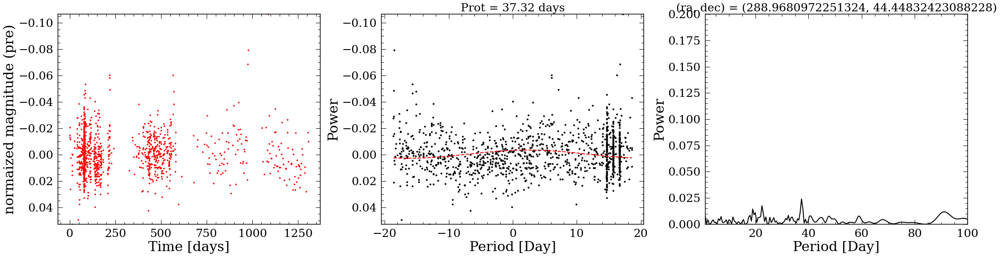

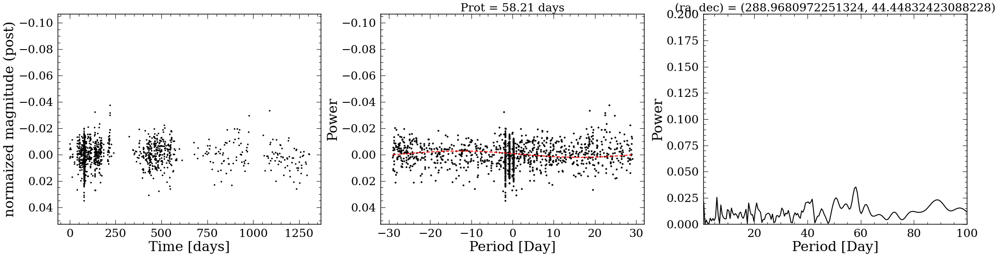

In [181]:
i=2
lctime, lcmags, medtrand, numbp = processlc([ras[i], decs[i]], gaiadata['ra'].values, 
          gaiadata['dec'].values, searchradius=5*60, pltorg=True)

In [193]:
def fitpoly(t,mag):
    p = fitpoints(t,mag,2)
    return t, mag-p(t)



def movingMed_time(t, mag, T_window,delta_T_window):
    # add in two columns for the median and put Nan's in them
    t_med=np.empty(len(mag))
    mag_med=np.empty(len(mag))
    t_med[:]=np.nan
    mag_med[:]=np.nan
    
    # define the boundaries of the windows
    window_min=float(min(t))
    window_max=float(window_min+delta_T_window)
    # max time
    maxtime=max(t)
    # break when time window hits the end
    while window_max<=maxtime+T_window:
        seldf=((t>=window_min) & (t<=window_max)) # get points between the window
        
        t_med[seldf]=np.median(t[seldf]) # all values for these indices are subsituded with median time
        mag_med[seldf]=np.median(mag[seldf]) # all values for these indices are subsituded with median flux

        window_min=window_min+delta_T_window
        window_max=window_max+delta_T_window
    return t_med, mag_med


100%|██████████| 43/43 [00:11<00:00,  3.65it/s]


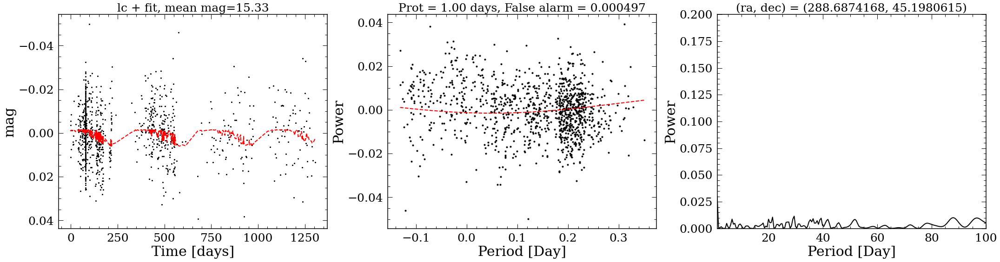

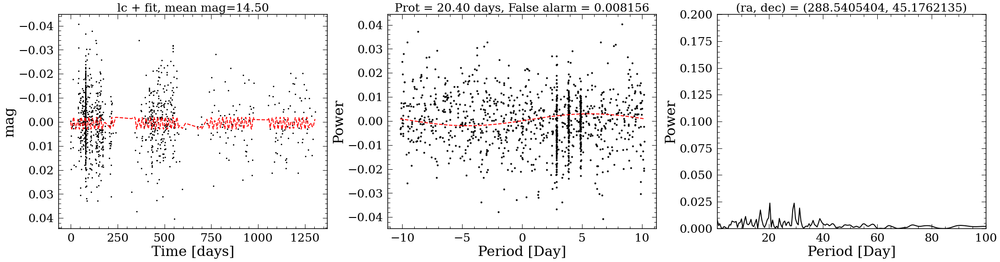

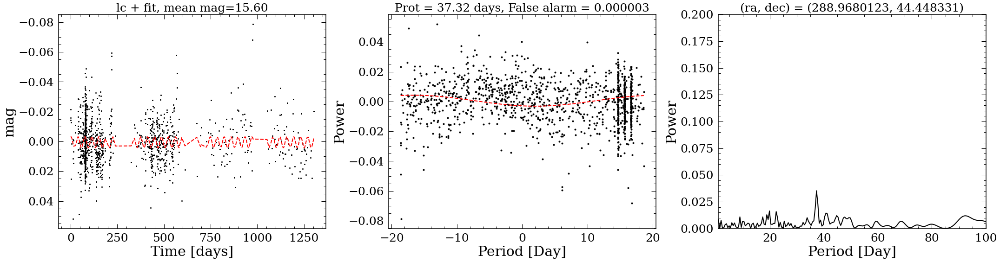

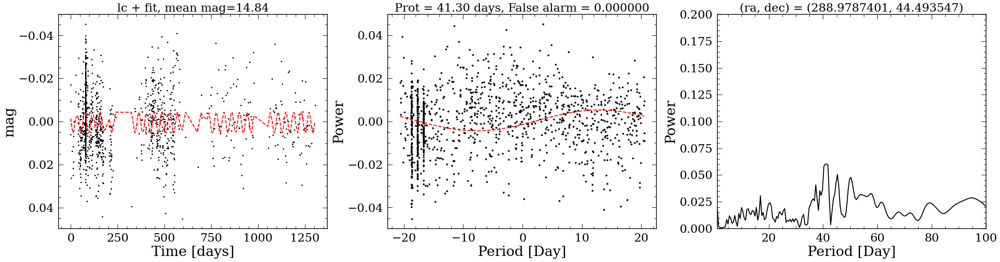

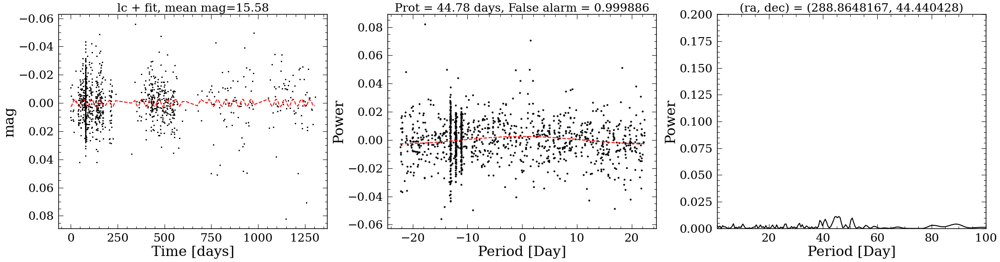

...

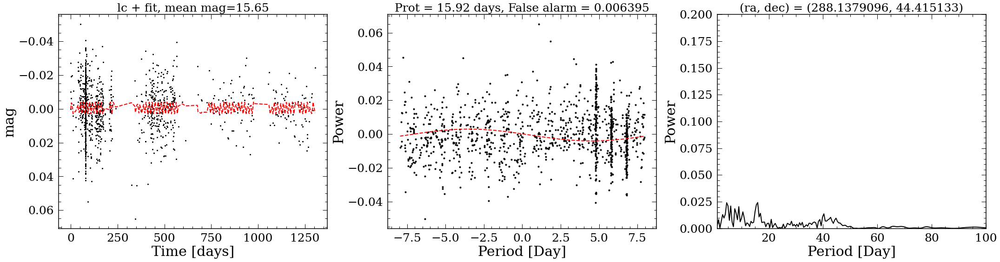

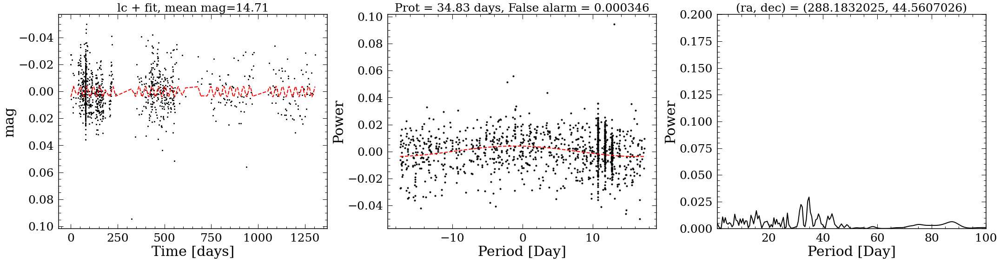

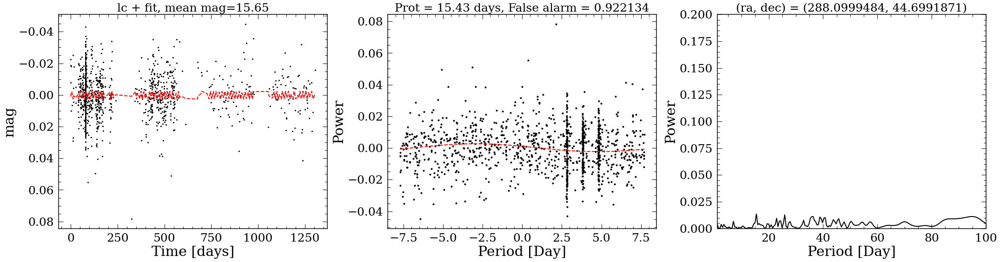

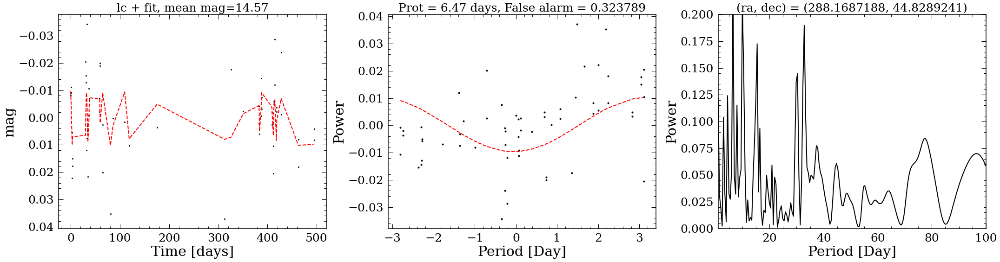

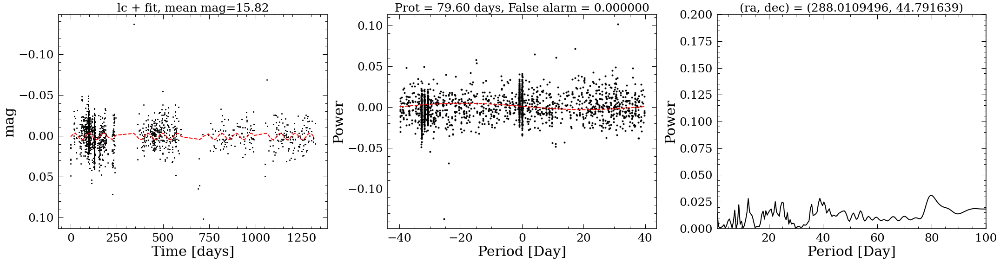

In [183]:
# no processing 
from astropy.timeseries import LombScargle
import warnings
warnings.filterwarnings('ignore')

ra_d = np.zeros(len(ras))
dec_d = np.zeros(len(ras))
for i in trange(len(ras)):
    lc_s = pd.read_table('./lc/ra_'+str(ras[i])+'_dec_'+str(decs[i]), delim_whitespace=True, skiprows=54,
             names=['oid','expid','hjd','mjd','mag','magerr','catflags','filtercode',
                     'ra','dec','chi','sharp','filefracday','field','ccdid','qid','limitmag','magzp',
                     'magzprms','clrcoeff','clrcounc','exptime','airmass','programid'])
    
    lc_s = lc_s.loc[lc_s['filtercode']=='zr'].reset_index(drop=True)
    lc_s = lc_s.sort_values(by='hjd')
    
    if len(lc_s)==0:
        print('No lc!')
        continue
    
    medt, medmag = movingMed_time((lc_s['mjd'].values-min(lc_s['mjd'])), lc_s['mag'].values, 1, 3)
    good_ind = abs(lc_s['mag'].values-medmag)/lc_s['magerr']<3.5
    lc_s = lc_s[good_ind].dropna().reset_index(drop=True)
    
    t, mag = fitpoly((lc_s['mjd'].values-min(lc_s['mjd'])), lc_s['mag'].values)
    prots = np.linspace(1,100,200)*u.day
    frequency = 1/prots
    power = LombScargle(t * u.day, mag * u.mag, 
                                   lc_s['magerr'].values* u.mag).power(frequency)
    ls = LombScargle(t * u.day, mag * u.mag, lc_s['magerr'].values* u.mag)
    
    fa = ls.false_alarm_probability(power.max())
    
    best_frequency = frequency[np.argmax(power)]
    y_fit = ls.model(t * u.day, best_frequency)

    plt.figure(figsize=(30,8))
    plt.subplot(1,3,1)
    plt.scatter(t ,mag, c='k',s=4)
    plt.plot(t, y_fit, 'r--')
    plt.xlabel('Time [days]')
    plt.ylabel('mag')
    plt.gca().invert_yaxis()
    plt.title('lc + fit, mean mag=%.2f'%(np.mean(lc_s['mag'].values)), fontsize=25)

    plt.subplot(1,3,2)
    P = 1/best_frequency
    t_fold=(t-np.median(t))-np.round((t-np.median(t))/P.value)*P.value
    plt.plot(t_fold,  mag, 'k.')   
    t_fold, mag = zip(*sorted(zip(t_fold, mag)))
    mag_fit = ls.model(t_fold * u.day, best_frequency)
    plt.plot(t_fold, mag_fit, 'r--')
    plt.xlabel('Period [Day]')
    plt.ylabel('Power')
    plt.tight_layout()
    plt.title('Prot = %.2f days, False alarm = %.6f'%(P.value, fa), fontsize=25)

    plt.subplot(1,3,3)
    plt.plot(1/frequency, power, 'k-')   
    plt.xlim(1,100)
    plt.xlabel('Period [Day]')
    plt.ylabel('Power')
    plt.ylim([0,0.2])
    plt.tight_layout()

    plt.title('(ra, dec) = ('+str(lc_s['ra'].values[0])+', '+str(lc_s['dec'].values[0])+')',fontsize=25)

    
    
    ra_d[i] = lc_s['ra'].values[0]
    dec_d[i] = lc_s['dec'].values[0]
    

# test best search radii for nearby stars

In [199]:
lcnumb = 17
from IPython.display import clear_output
# optimize search radii
search_r = np.linspace(0.5, 10, 20)*60

prots = np.linspace(1,100,200)*u.day
frequency = 1/prots
scatterings = np.zeros((lcnumb, len(search_r)))
maxpower = np.zeros((lcnumb, len(search_r)))
medpower = np.zeros((lcnumb, len(search_r)))
for j in trange(lcnumb):
    for i in range(len(search_r)):
        lctime, lcmags, medmags, numbp = processlc([ras[j], decs[j]], gaiadata['ra'].values, 
                                          gaiadata['dec'].values, searchradius=search_r[i], 
                                          pltorg=False)

        power = LombScargle(lctime * u.day, lcmags * u.mag).power(frequency)
        ls_2 = LombScargle(lctime * u.day, lcmags * u.mag)

        best_frequency = frequency[np.argmax(power)]
        y_fit = ls_2.model(lctime * u.day, best_frequency)

        scatterings[j,i] = np.std(lcmags-y_fit.value)
        maxpower[j,i] = max(power)
        medpower[j,i] = np.median(power)
    clear_output(wait=True)



100%|██████████| 17/17 [13:02:21<00:00, 2761.24s/it]


In [200]:
for j in range(len(scatterings[:,0])):
    scatterings[j,:] = scatterings[j,:]/np.median(pd.Series(scatterings[j,:]).dropna())
    maxpower[j,:] = maxpower[j,:]/np.median(pd.Series(maxpower[j,:]).dropna())
    medpower[j,:] = medpower[j,:]/np.median(pd.Series(medpower[j,:]).dropna())


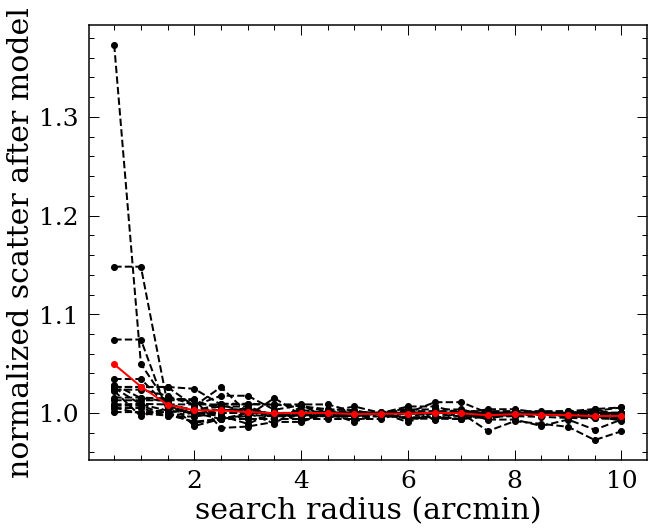

In [201]:
plt.figure(figsize=(10,8))
for j in range(lcnumb):
    plt.plot(search_r/60, scatterings[j,:], 'k--o')
plt.xlabel("search radius (arcmin)")
plt.ylabel('normalized scatter after model')

scatterings_mean = np.zeros(len(search_r))
for j in range(len(search_r)):
    scatterings_mean[j] = np.mean(scatterings[:,j])
plt.plot(search_r/60, scatterings_mean, 'r-o')





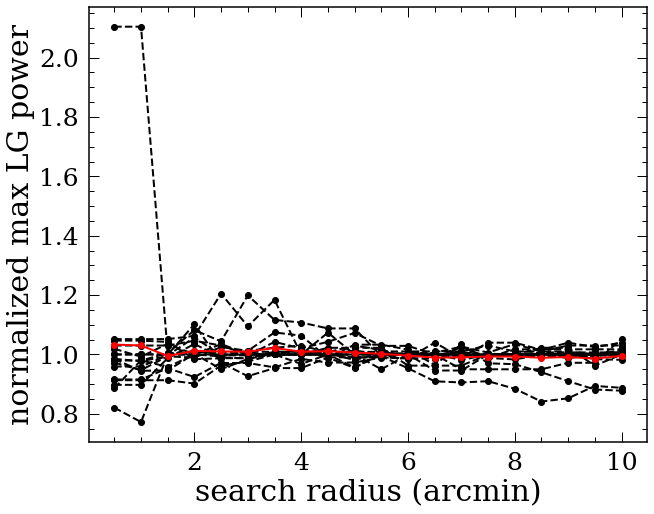

In [202]:
plt.figure(figsize=(10,8))
for j in range(lcnumb):
    plt.plot(search_r/60, maxpower[j,:], 'k--o')
plt.xlabel("search radius (arcmin)")
plt.ylabel('normalized max LG power')

maxpower_mean = np.zeros(len(search_r))
for j in range(len(search_r)):
    maxpower_mean[j] = np.mean(maxpower[:,j])
plt.plot(search_r/60, maxpower_mean, 'r-o')



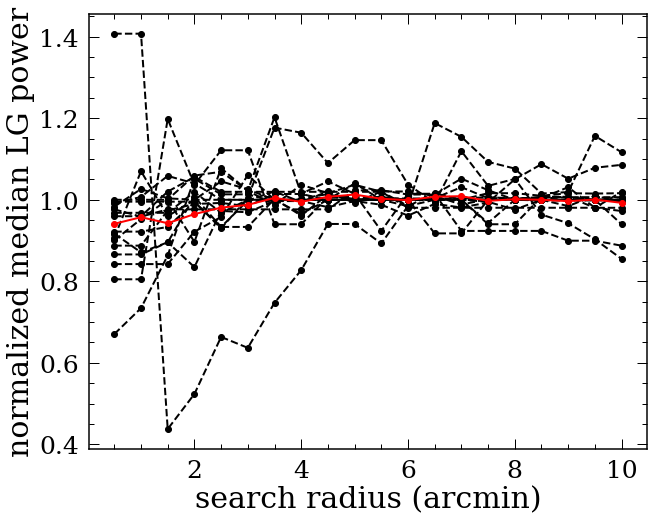

In [203]:
plt.figure(figsize=(10,8))
for j in range(lcnumb):
    plt.plot(search_r/60, medpower[j,:], 'k--o')
plt.xlabel("search radius (arcmin)")
plt.ylabel('normalized median LG power')

medpower_mean = np.zeros(len(search_r))
for j in range(len(search_r)):
    medpower_mean[j] = np.mean(medpower[:,j])
plt.plot(search_r/60, medpower_mean, 'r-o')


# Try 50 stars with new method

100%|██████████| 43/43 [50:15<00:00, 70.13s/it] 


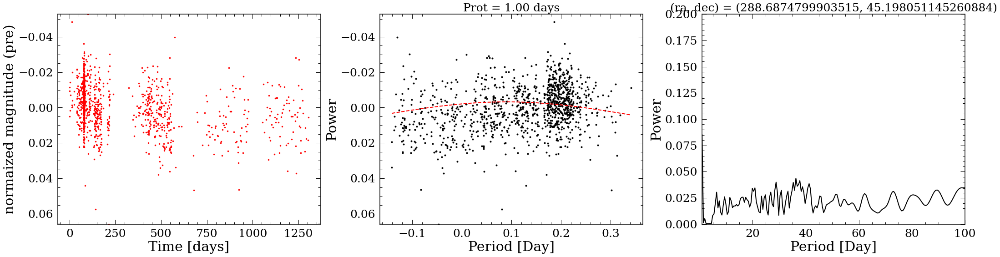

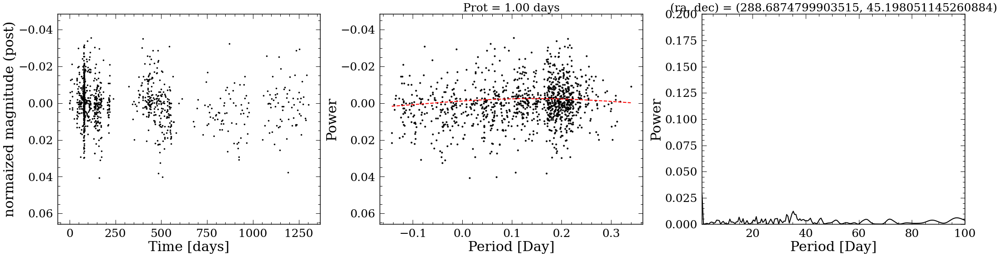

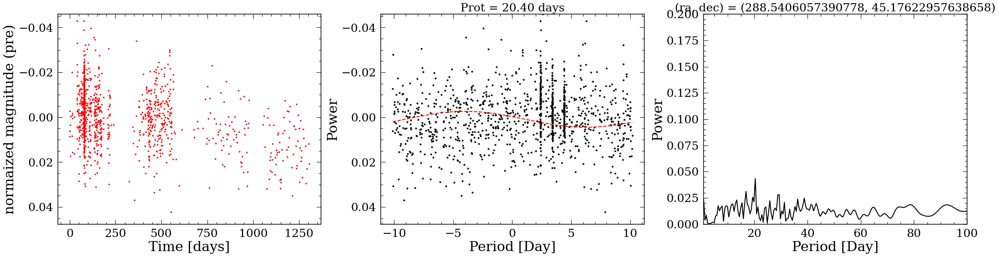

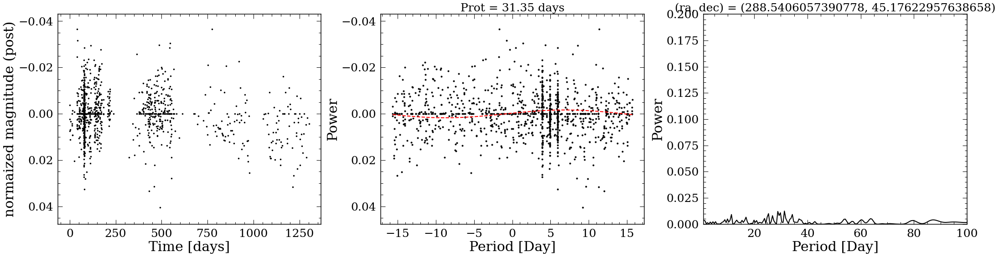

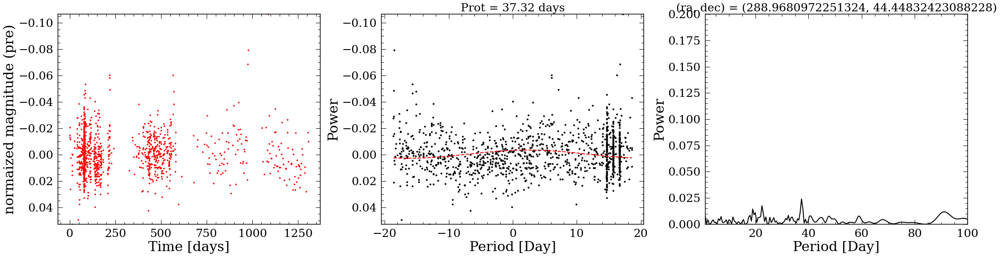

...

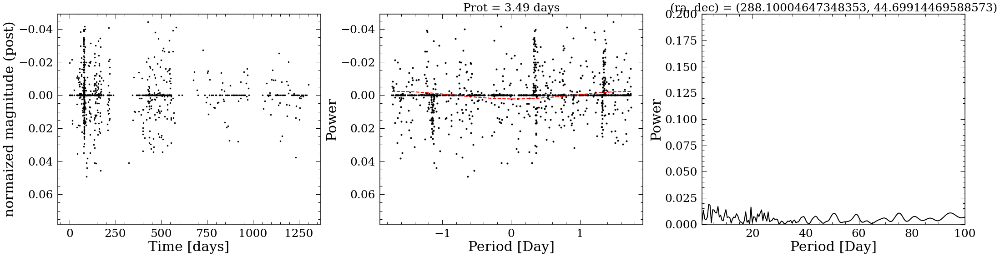

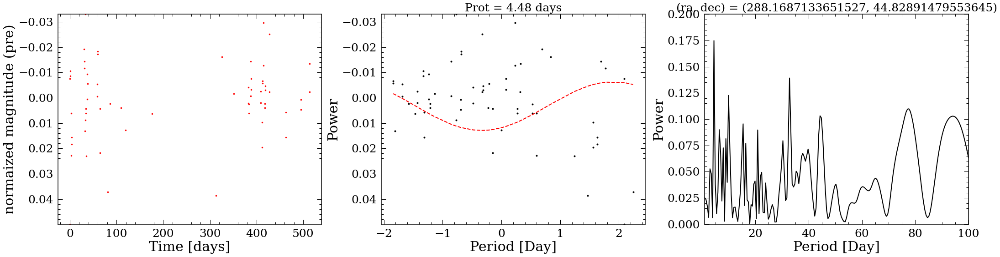

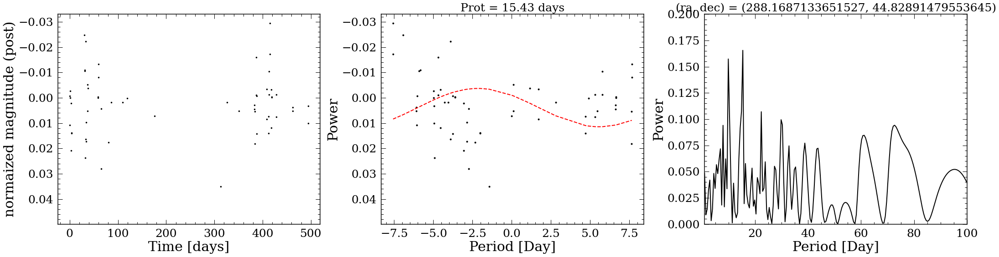

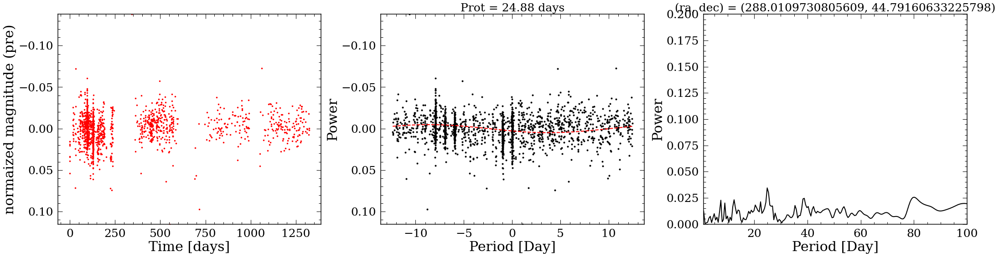

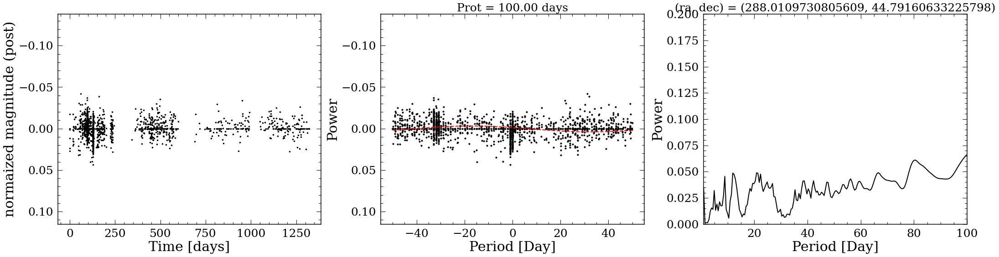

In [204]:

for i in trange(len(ras)):
    print('Using search radius:', 4, 'arcmin')
    lctime, lcmags, medtrand, numbp = processlc([ras[i], decs[i]], gaiadata['ra'].values, 
                              gaiadata['dec'].values, pltorg=True, 
                                searchradius=2*60)
    """
    plt.figure(figsize=(20,5))
    plt.plot(lctime, medtrand, 'k.')
    plt.xlabel('time [days]')
    plt.ylabel('med of mag')
    plt.gca().invert_yaxis()
    """
    clear_output(wait=True)
    
    

# PCA

In [145]:
colnames = ['oid','expid','hjd','mjd','mag','magerr','catflags','filtercode',
                     'ra','dec','chi','sharp','filefracday','field','ccdid','qid','limitmag','magzp',
                     'magzprms','clrcoeff','clrcounc','exptime','airmass','programid']
ilists=[]
for i in trange(100):
    if i == 0:
        mainlc = pd.read_table('./lc/ra_'+str(ras[0])+'_dec_'+str(decs[0]),
            delim_whitespace=True, skiprows=54, names=colnames)
        mainlc = mainlc.sort_values(by='mjd').reset_index(drop=True)
        mainlc['mag0'] = mainlc['mag']-np.median(mainlc['mag'])
        print(mainlc['oid'].values[0])
        ilists.append(i)
    else:
        try:
            mainlc_o = pd.read_table('./lc/ra_'+str(ras[i])+'_dec_'+str(decs[i]),
                delim_whitespace=True, skiprows=54, names=colnames)
        except:
            continue
        if len(mainlc_o)<500:
            continue
        ilists.append(i)
        mainlc_o = mainlc_o.sort_values(by='mjd').reset_index(drop=True)
        mainlc_o['mag'+str(i)] = mainlc_o['mag']-np.median(mainlc_o['mag'])
        mainlc=pd.merge(mainlc,mainlc_o[['mjd','mag'+str(i)]],
                        left_on='mjd', right_on='mjd', how='inner')
        print(mainlc_o['oid'].values[0])
        

 20%|██        | 20/100 [00:00<00:00, 96.97it/s]

766204200041459
766204100015935
766204200041251
766204200015598
766204200015389
766204200040874
766204200014103
766204200027719
766204100014323
766204100014315
766204200012988
766204200013393
766204200027698
766204200027570
766204200027599
766204200013985
766204200013001
766204400013410
766204400027487
766204400027080


 40%|████      | 40/100 [00:00<00:00, 97.81it/s]

766204400011813
766204400035904
766204400010295
766204400035741
766204400026363
766204400026099
766204400009650
766204400009119
766204400025704
766204400044258
766204400007833
766204400011940
766204400011304
766204400026756
766204400041138
766204400026187
766204400009554
766204400025470
766204400026473
766204300008107
766204400008532


 62%|██████▏   | 62/100 [00:00<00:00, 99.25it/s] 

766204400008082
766204400007512
766204400007384
766204400035465
766204400008198
766204400025017
766204400007578
766204400006735
766204400006923
766204300007326
766204300006551
766204300005410
766204300005194
766204300022453
766204400006126
766204400006127
766204300022521
766204300022138
766204300003802


 82%|████████▏ | 82/100 [00:00<00:00, 97.85it/s]

766204300003936
766204300003655
766204300003609
766204300002421
766204300002893
766204300002542
766204400006164
766204400006022
766204400004555
766204400002511
766204400001998
766204400001284
766204400001106
766204400000647
766204400000743
766204400001321
766204400000674
766204400000204
766204400000441


100%|██████████| 100/100 [00:00<00:00, 102.85it/s]

766204400000189
766204400023276
766204400000877
766204300001503
766204300001095
766204300000357
766204200021621
766204100043584
766204100022008
766204100022360
766204100019349


In [146]:

normtime = min(mainlc['mjd'])
mainlc['mjd'] = mainlc['mjd']-normtime
mainlc = mainlc[np.append(['mjd'],['mag'+str(i) for i in ilists])].dropna()

X = mainlc[['mag'+str(i) for i in ilists]].values.T
np.shape(X)



(90, 238)

In [147]:
from sklearn.decomposition import PCA

In [156]:
pca = PCA(n_components=90)

In [157]:
pca.fit(X)

PCA(n_components=90)

In [158]:
np.shape(pca.components_)

(90, 238)

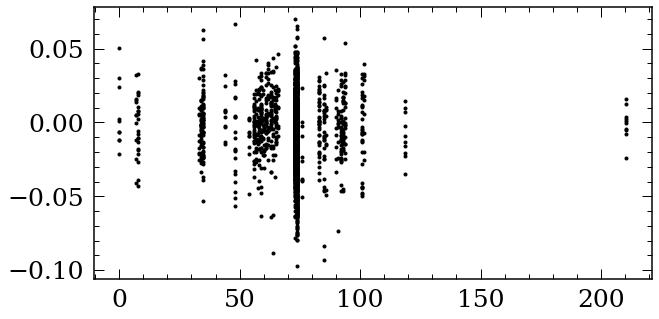

In [159]:
plt.figure(figsize=(10,5))
for i in range(10):
    plt.plot(mainlc['mjd'],X[i,:],'k.')

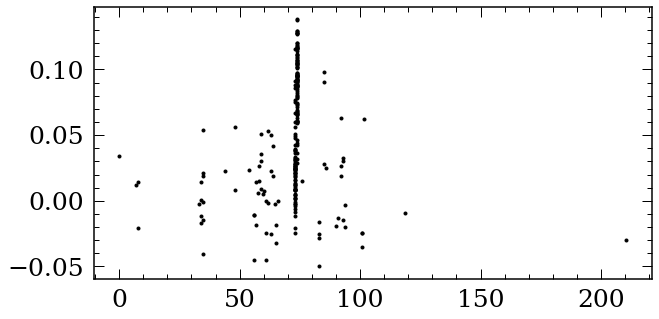

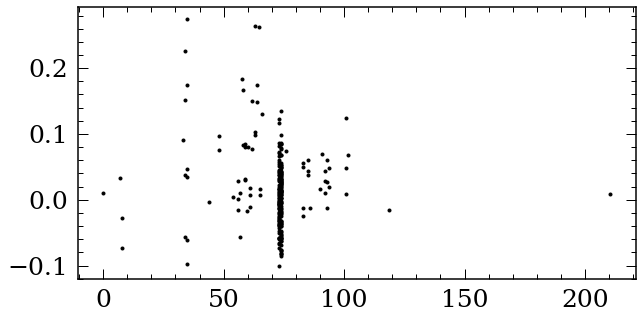

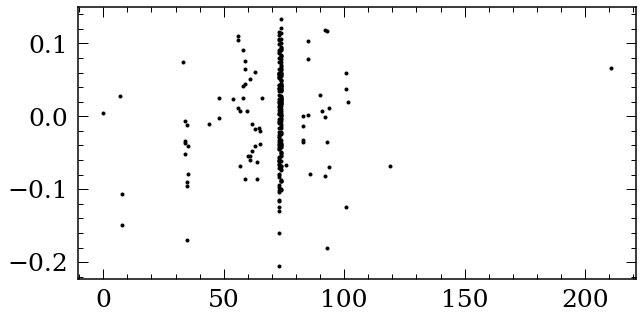

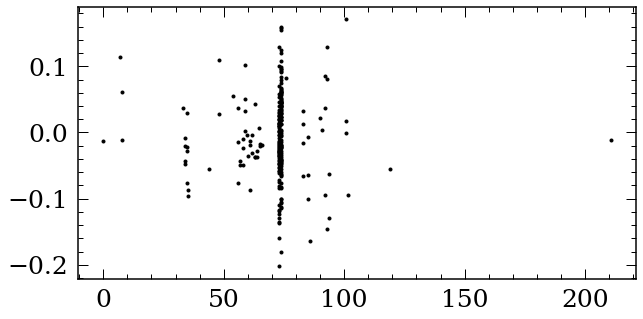

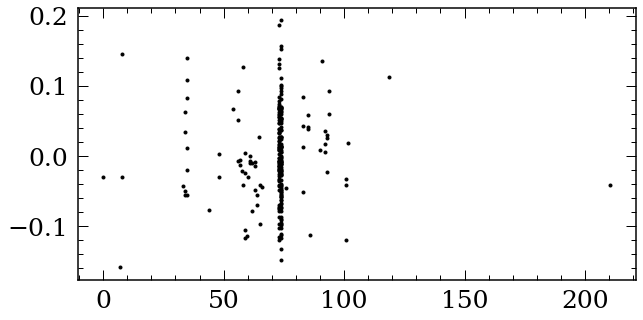

...

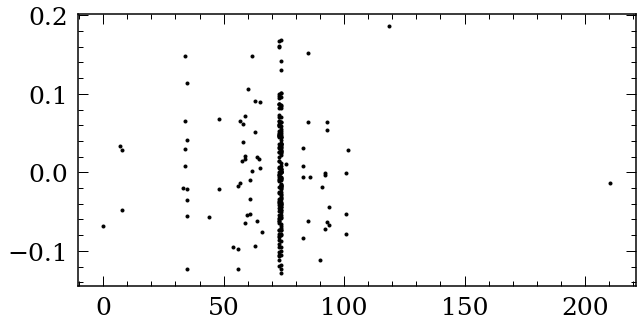

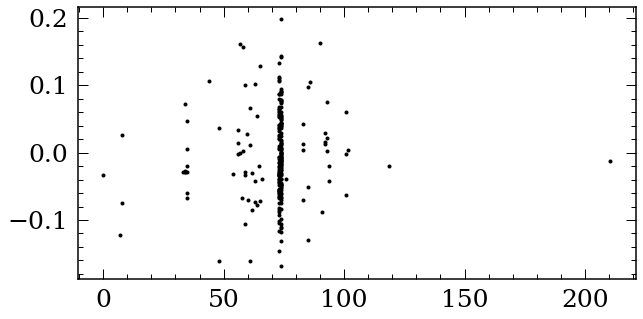

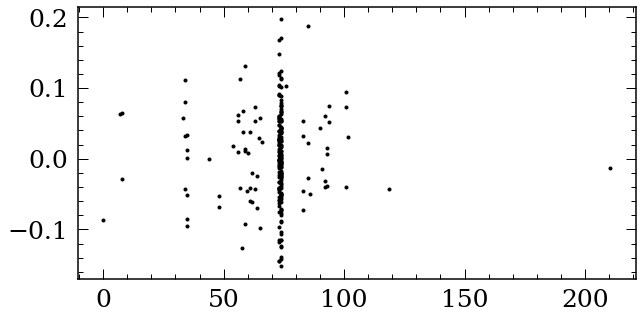

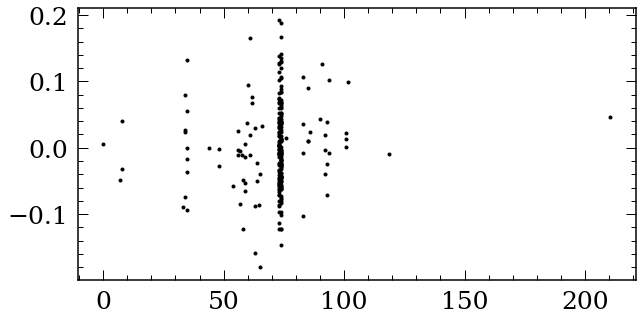

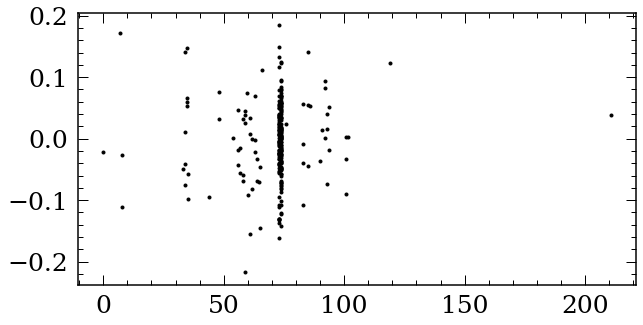

In [161]:
for i in range(90):
    plt.figure(figsize=(10,5))
    plt.plot(mainlc['mjd'],pca.components_[i,:],'k.')

